<a href="https://colab.research.google.com/github/Danangellotti/Ciencia_de_Datos_UGR_24/blob/main/Plantas_de_emergia_global.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error

In [3]:
# Cargar el dataset de plantas de energía
url = "https://raw.githubusercontent.com/wri/global-power-plant-database/master/output_database/global_power_plant_database.csv"
data = pd.read_csv(url)

# Mostrar las primeras filas del dataset
data.head()


<ipython-input-3-934395072698>:3: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(url)


,country,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,...,estimated_generation_gwh_2013,estimated_generation_gwh_2014,estimated_generation_gwh_2015,estimated_generation_gwh_2016,estimated_generation_gwh_2017,estimated_generation_note_2013,estimated_generation_note_2014,estimated_generation_note_2015,estimated_generation_note_2016,estimated_generation_note_2017
0,AFG,Afghanistan,Kajaki Hydroelectric Power Plant Afghanistan,GEODB0040538,33.0,32.322,65.1190,Hydro,NaN,NaN,...,123.77,162.90,97.39,137.76,119.50,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1
1,AFG,Afghanistan,Kandahar DOG,WKS0070144,10.0,31.670,65.7950,Solar,NaN,NaN,...,18.43,17.48,18.25,17.70,18.29,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE
2,AFG,Afghanistan,Kandahar JOL,WKS0071196,10.0,31.623,65.7920,Solar,NaN,NaN,...,18.64,17.58,19.10,17.62,18.72,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE
3,AFG,Afghanistan,Mahipar Hydroelectric Power Plant Afghanistan,GEODB0040541,66.0,34.556,69.4787,Hydro,NaN,NaN,...,225.06,203.55,146.90,230.18,174.91,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1
4,AFG,Afghanistan,Naghlu Dam Hydroelectric Power Plant Afghanistan,GEODB0040534,100.0,34.641,69.7170,Hydro,NaN,NaN,...,406.16,357.22,270.99,395.38,350.80,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1


In [4]:
# Verificar valores nulos en el dataset
data.isnull().sum()


,0
country,0
country_long,0
name,0
gppd_idnr,0
capacity_mw,0
latitude,0
longitude,0
primary_fuel,0
other_fuel1,32992
other_fuel2,34660


In [5]:
# Eliminar registros con información geográfica incompleta
data = data.dropna(subset=['latitude', 'longitude'])


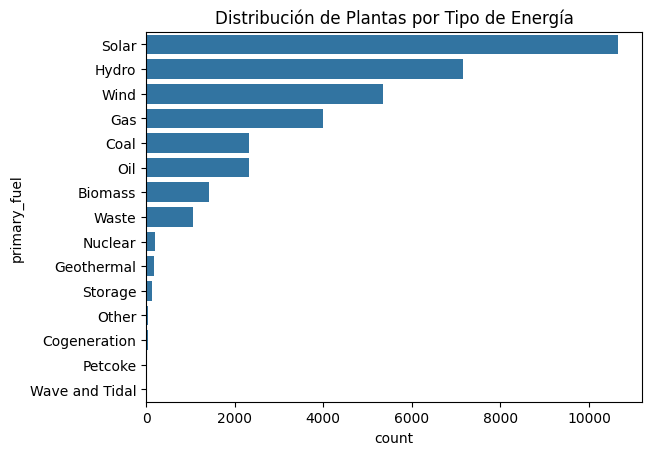

In [6]:
sns.countplot(y='primary_fuel', data=data, order=data['primary_fuel'].value_counts().index)
plt.title('Distribución de Plantas por Tipo de Energía')
plt.show()


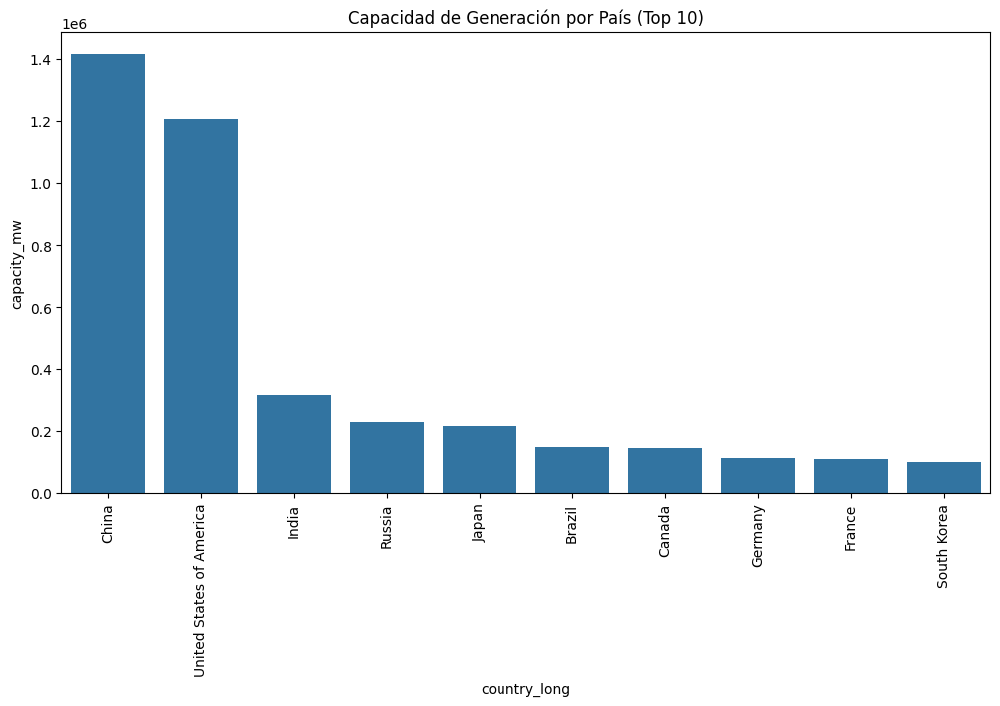

In [7]:
plt.figure(figsize=(12, 6))
sns.barplot(x='country_long', y='capacity_mw', data=data.groupby('country_long')['capacity_mw'].sum().reset_index().sort_values('capacity_mw', ascending=False).head(10))
plt.title('Capacidad de Generación por País (Top 10)')
plt.xticks(rotation=90)
plt.show()


In [8]:
# Crear un mapa
mapa = folium.Map(location=[0, 0], zoom_start=2)

# Agregar puntos de las plantas de energía
for _, row in data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        fill_opacity=0.7
    ).add_to(mapa)

mapa


In [9]:
X = data[['latitude', 'longitude', 'primary_fuel']]
y = data['capacity_mw']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [10]:
# Preprocesamiento de datos categóricos y entrenamiento del modelo
preprocessor = ColumnTransformer(transformers=[('cat', OneHotEncoder(), ['primary_fuel'])], remainder='passthrough')

pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', LinearRegression())])
pipeline.fit(X_train, y_train)


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat', OneHotEncoder(),
                                                  ['primary_fuel'])])),
                ('model', LinearRegression())])

In [11]:
y_pred = pipeline.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f"Error cuadrático medio (MSE): {mse}")


Error cuadrático medio (MSE): 217920.0541983187
